<a href="https://colab.research.google.com/github/GalYounous/Project2ML/blob/main/Projet2_ML.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Road Segmentation Project**

Set the good directory

In [ ]:
import os
from google.colab import drive
drive.mount('/content/gdrive')
os.chdir('/content/gdrive/MyDrive/ML Projet 2/')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


Imports...

In [ ]:
!pip install pytorch_lightning
from PIL import Image
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import numpy as np
from torchvision.transforms import ToPILImage
import torchvision.transforms as T
from CustomDataSet import CustomDataSet
from UNetLight import UNetLight
from UNet import UNet
from ModelWrapper import ModelWrapper
from TestDataSet import TestDataSet
from SoftDiceLoss import SoftDiceLoss
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
import pytorch_lightning as pl
from pytorch_lightning import loggers as pl_loggers
from pytorch_lightning.callbacks import ModelCheckpoint
import torch.nn.functional as F
import random as random
import torchvision
from sklearn.model_selection import train_test_split
from mask_to_submission import masks_to_submission

Set up transforms. Random transforms will be applied in the same manner for image and gt.

In [ ]:
trans_im = T.Compose([ # Image transforms
    T.RandomVerticalFlip(),
    T.RandomHorizontalFlip(),
    T.RandomRotation(30),
    T.ColorJitter(),
])
trans_gt = T.Compose([ # Some transforms are needed on the ground truth (rotations)
    T.RandomVerticalFlip(),
    T.RandomHorizontalFlip(),
    T.RandomRotation(30),
])

Set up Data sets

In [ ]:

train_ratio = 0.8 # Train Validation ratio
samples = np.arange(100)
random.seed(42) #To reproduce the same dataset split
random.shuffle(samples)

# Calculate the split index
split_index = int(len(samples) * train_ratio)
train_samples = samples[:split_index]
val_samples = samples[split_index:]

# Create dataset
train_dataset = CustomDataSet(im_trans=trans_im,gt_trans=trans_gt,samples=train_samples) #Training with transforms
val_dataset = CustomDataSet(samples=val_samples) #Validating without transforms

full_dataset = CustomDataSet(im_trans=trans_im,gt_trans=trans_gt,samples=np.arange(100))



Set up model and loss

In [ ]:
model = UNet()#UNetLight()
loss = SoftDiceLoss()
#loss = nn.BCELoss()

Set up dataloaders

In [ ]:

# Create data loaders for training and validation sets
batch_size = 8
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True,num_workers=2,persistent_workers=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False,num_workers=2,persistent_workers=True)


Set up ModelWraper, trainer checkpoints and logs

In [ ]:
name = input("Name the model : ")
pytorch_lightning_model = ModelWrapper(model,loss) #Model wrapper
tb_logger = pl_loggers.TensorBoardLogger(save_dir="logs/", name=name) # Logs
checkpoint_callback = ModelCheckpoint(dirpath='checkpoints',filename=name+'-{epoch}-{val_F1:.2f}',monitor="val_F1",mode="max") # Checkpoints
trainer = pl.Trainer(max_epochs=600, accelerator="gpu", devices=[0],logger=tb_logger, callbacks=[checkpoint_callback],log_every_n_steps=1) #Trainer

Name the model : BCELoss


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


Load tensor board

In [ ]:
!kill 1079
%load_ext tensorboard
%tensorboard --logdir logs

/bin/bash: line 1: kill: (1079) - No such process
The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 6770), started 0:00:13 ago. (Use '!kill 6770' to kill it.)

<IPython.core.display.Javascript object>

Train !

In [29]:
trainer.fit(pytorch_lightning_model, train_dataloaders=train_loader, val_dataloaders=val_loader) #Train
#trainer.fit(pytorch_lightning_model, train_dataloaders=train_loader, val_dataloaders=val_loader,ckpt_path='checkpoints/UNet-Rot30FlipColor-epoch=359-val_F1=0.96.ckpt') #Train

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type      | Params
----------------------------------------
0 | loss_func | BCELoss   | 0     
1 | model     | UNetLight | 1.9 M 
----------------------------------------
1.9 M     Trainable params
0         Non-trainable params
1.9 M     Total params
7.778     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

RuntimeError: ignored

List checkpoints

In [ ]:
!ls checkpoints

'BCELoss-epoch=167-val_F1=0.85.ckpt'
'encoreun test de maerde-epoch=27-val_F1=0.83.ckpt'
'Joligraf-epoch=272-val_F1=0.85.ckpt'
'okgoogle-epoch=479-val_F1=0.97.ckpt'
'tamere-epoch=116-val_F1=0.84.ckpt'
'tamere-epoch=24-val_F1=0.81.ckpt'
'tamere-epoch=34-val_F1=0.82.ckpt'
'tamere-epoch=43-val_F1=0.83.ckpt'
'tamere-epoch=57-val_F1=0.84.ckpt'
'tamere-epoch=97-val_F1=0.84.ckpt'
'TestAEffacer-epoch=5-val_F1=0.54.ckpt'
'UNetLight-epoch=93-val_F1=0.85.ckpt'
'UNetLightRot30-epoch=135-val_F1=0.85.ckpt'
'UNetLightRot30FlipColor-epoch=165-val_F1=0.87.ckpt'
'UNetLightRot90-epoch=385-val_F1=0.87.ckpt'
'UNet-Rot30FlipColor-epoch=221-val_F1=0.86.ckpt'
'UNet-Rot30FlipColor-epoch=359-val_F1=0.96.ckpt'
'younous overfit enculé-epoch=67-val_F1=0.84.ckpt'
'YOUNOUS OVERFIT-epoch=9-val_F1=0.65.ckpt'
'YouNous présentation-epoch=44-val_F1=0.76.ckpt'


Use the model to predict

In [30]:
# Visualize predictions and ground truths

test_dataset = TestDataSet() # Test data set for submission
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False,num_workers=2)


checkpoint = input("Enter the name of the checkpoint file : ")
checkpoint_path = "checkpoints/"+checkpoint
rs = trainer.predict(pytorch_lightning_model, dataloaders=test_loader,ckpt_path=checkpoint_path)


Enter the name of the checkpoint file : Joligraf-epoch=272-val_F1=0.85.ckpt


INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at checkpoints/Joligraf-epoch=272-val_F1=0.85.ckpt
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.utilities.rank_zero:Loaded model weights from the checkpoint at checkpoints/Joligraf-epoch=272-val_F1=0.85.ckpt


Predicting: |          | 0/? [00:00<?, ?it/s]

Visualize

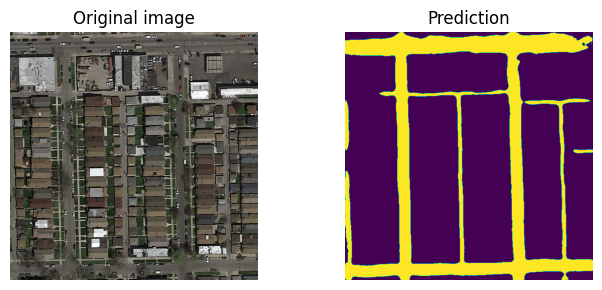

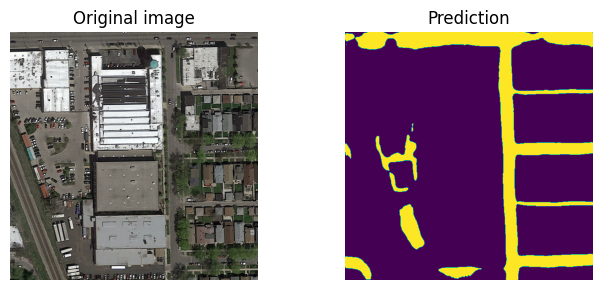

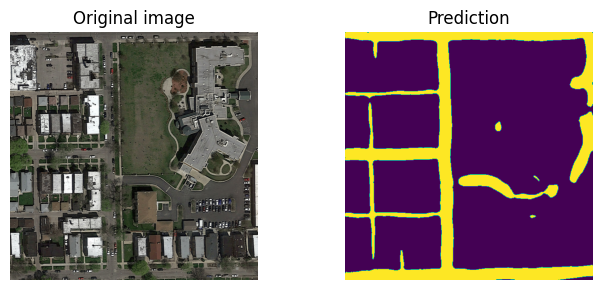

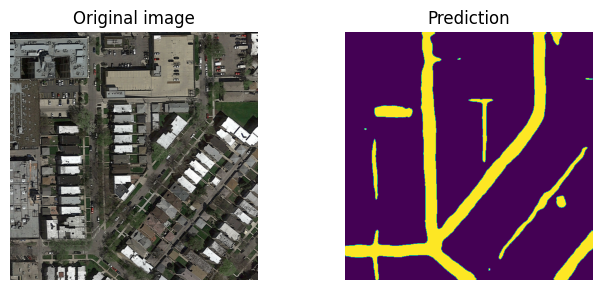

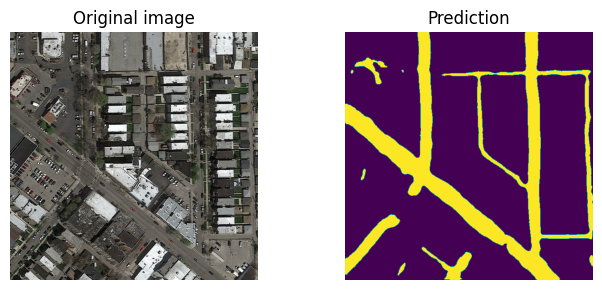

...

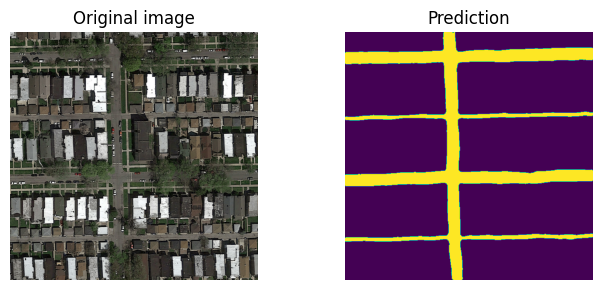

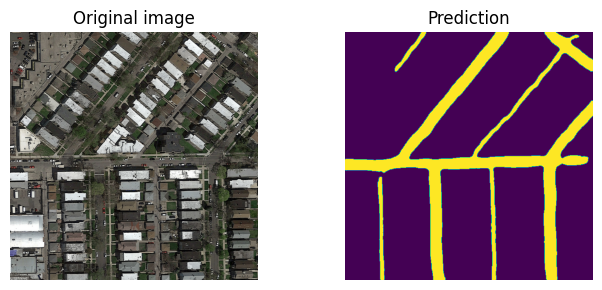

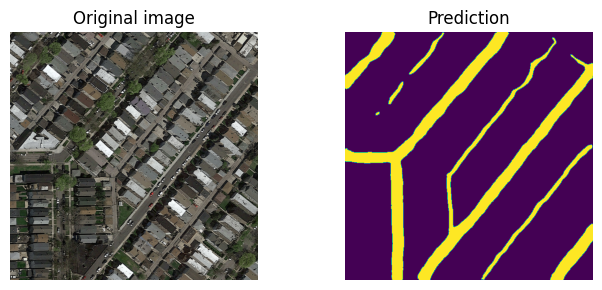

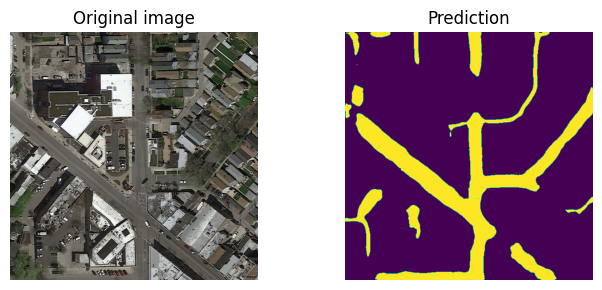

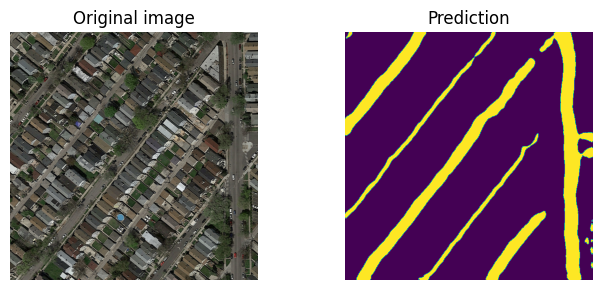

In [35]:
to_pil = ToPILImage()
# Display the image using matplotlib
for truc in rs:

  if(len(truc)==3): #If there is ground truth
    pred=to_pil((truc[0].squeeze()>0.5).float()) #Print prediction
    gt=to_pil(truc[2].squeeze()) #Print prediction
    image=to_pil(truc[1].squeeze())
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    axs[0].imshow(image)
    axs[0].set_title("Original image")
    axs[0].axis('off')
    axs[1].imshow(gt)
    axs[1].set_title("Ground truth")
    axs[1].axis('off')
    axs[2].imshow(pred)
    axs[2].set_title("Prediction")
    axs[2].axis('off')
    plt.tight_layout()
    plt.show()

  else:  #If there isn't ground truth
      pred=to_pil((truc[0].squeeze()>0.7).float()) #Print prediction
      image=to_pil(truc[1].squeeze())
      fig, axs = plt.subplots(1, 2, figsize=(7, 3))
      axs[0].imshow(image)
      axs[0].set_title("Original image")
      axs[0].axis("off")
      axs[1].imshow(pred)
      axs[1].set_title("Prediction")
      axs[1].axis('off')
      plt.tight_layout()
      plt.show()


Save predictions as files

In [ ]:
#Save test predictions
directory = "test_set_images/predictions"
os.makedirs(directory, exist_ok=True)

file_names = []
for i,batch in enumerate(rs):
  mask = to_pil((batch[0].squeeze()>0.5).float())
  file_name = directory+"/pred_{}.png".format(i+1)
  file_names.append(file_name)
  mask.save(file_name)


Create csv submission

In [ ]:
#Create submission
submission_path = directory+"/submission_{}.csv".format(name)
masks_to_submission(submission_path,file_names)

test_set_images/predictions/pred_1.png
test_set_images/predictions/pred_2.png
test_set_images/predictions/pred_3.png
test_set_images/predictions/pred_4.png
test_set_images/predictions/pred_5.png
test_set_images/predictions/pred_6.png
test_set_images/predictions/pred_7.png
test_set_images/predictions/pred_8.png
test_set_images/predictions/pred_9.png
test_set_images/predictions/pred_10.png
test_set_images/predictions/pred_11.png
test_set_images/predictions/pred_12.png
test_set_images/predictions/pred_13.png
test_set_images/predictions/pred_14.png
test_set_images/predictions/pred_15.png
test_set_images/predictions/pred_16.png
test_set_images/predictions/pred_17.png
test_set_images/predictions/pred_18.png
test_set_images/predictions/pred_19.png
test_set_images/predictions/pred_20.png
test_set_images/predictions/pred_21.png
test_set_images/predictions/pred_22.png
test_set_images/predictions/pred_23.png
test_set_images/predictions/pred_24.png
test_set_images/predictions/pred_25.png
test_set_